# AUPE Processing for Ries Crater Field Trip May 2025

A notebook for developing a processing library and pipeline for AUPE colour and multispectral image processing.

Developed for processing of the Ries Crater field trip, May 2025.

R. Stabbins  
Natural History Museum, London, UK  
7/5/2025

# Overview

1. Set data input and output directories.
2. Access raw input images
3. Set/Read AUPE metadata
   1. Map channel names to cwl, fwhm
   2. Read calibration target reflectance data
   3. sample calibration target reflectance to channel cwls & fwhms
4. Process HRC frames:
   1. Load HRC image
   2. Debayer
   3. Stack to RGB
   4. Apply Colour Correction Matrix (get from a Cal Targ scene)
   5. Display processed HRC image
   6. Save HRC RGB image 
5. Process RGB frames:
   1. Load RGB channels: images + metadata
   2. Apply flat fields (?)
   3. Exposure correct
   4. Convert to 8-bit, stack to RGB
   5. ROI select Colorchecker patches
   6. Get dRGB patch values (from ROI)
   7. Solve for colour correction matrix to sRGB D65 reference values
   8. Apply color correction matrix to dRGB image
   9. Display colour WAC frame
   10. Save WAC RGB frame
6. Process multispectral frames
   1. Load multispectral channels: images + metadata
   2. Apply flat fields (?)
   3. Exposure correct
   4. ROI select Colorchecker patches (or import from RGB?)
   5. Get float DN/s patch values 
   6. Fit patch values to reference reflectance, for each channel
   7. Apply reflectance calibration coefficients to each image
7. Warp LWAC to RWAC
   1. Find tie points from LWAC RGB -> RWAC RGB
   2. Get homography matrix
   3. Apply rectification to LWAC RGB
   4. Apply rectification to LWAC multispec

# Log of Terminal Setup Commands

Copy each of these lines into the terminal and run one at a time.

```conda create -n aupy_dev
conda activate aupy_dev
conda install python matplotlib numpy scipy pillow pandas
conda install opencv

Select ```aupy_dev``` as the kernel to use for running this notebook.

# Code Design

Here is the initial plan for the aupy.py library.

**aupe info**
- attributes:
  - cwls
  - fwhms
  - cam_dict
  - version
- methods:
  - load aupe info

**calibration target**
- attributes
  - patch names list
  - patch reference reflectance values array (reflectance units)
  - patch reference sRGB values array (DN uint8 units)
  - patch roi coordinates array
  - patch observed values (mean, std. dev., other fit metrics)
- methods
  - load calibration target data
  - load patch roi coordinates (if file is presence and pref.)
  - draw patch rois (accepts rgb/grayscale image) (if a patch is not there or bad, allow to skip drawing of roi, and handle appropriately down stream)
  - measure patch mean, std. dev. (optionally fit Guassian to histo.), handle overexposed pixels and outliers.
  - save patch roi coordinates (in way that can optionally be loaded)

**img**  
- attributes:
  *metadata*
  - filename
  - parent directory
  - scene
  - sol
  - channel (e.g. LWAC_R, HRC_B, RWAC_G01...)
  - camera
  - pan
  - tilt
  - exposure
  - width
  - height
  - capture timestamp
  - units
  - stretch
  - stretch_coeff
  *data*
  - image
- methods:
  - display image (using stretch)
  - export image (either using stretch, or in float format)
  - extract stretch coefficient
    - brightest pixel
    - white pixel (from roi)
    - set manual
  - load image
  - exposure correction
  - flat field
  - dark/bias correction

**rgb**:  
- attributes
  - red, green, blue images (dict of img objects)
  - red, green, blue source channel names (dict of strs) could be spectral parameters...
  - red, green, blue source exposure values
  - rgb image (w x h x 3 np.ndarray)
  - colour correction matrix (3x3 np.ndarry)
  - colour balance vector (3x1 np.array)
  - camera (str)
  - scene (str)
  - sol (str)
  - pan (float)
  - tilt (float)
  - start timestamp (lowest of each image) (str)
  - units (str: 'DN', 'DN/s', 'R*')
  - stretch (str: none, bpwb, wpwb, ctc, ctr) # make sure all stretches applied to all channels...)
  - calibration target (separate object)
- methods
  - display rgb image
  - export rgb image
  - display rgb histogram
  - display r,g,b, frames
  - display r,g,b histograms
  - exposure correct all channels
  - flat field all channels
  - bias subtract all channels
  - apply colour correction matrix (stretch and mix channels)
    - update stretch label to ctc
  - apply colour balance vector (stretch channels independently)
    - update stretch label to bpwb or wpwb
  - load calibration target
  - extract colour correction matrix
    - *need method for only selecting patches that are in the scene...*
    - solve for calibration target patch sRGB values (or go to XYZ first)
  - extract colour balance vector
    - a. brightest pixel
    - b. white pixel/roi
  
**hrc**
- inherits from rgb  
- attributes
  - bayered image (raw image)
- methods
  - display raw bayered image
  - debayer image (straight into an aupe_rgb object)

**wac_ms**  
- attributes:
  - band images (dict of img objects) # note should be able to treat a broadband colour channel as a band here
  - band source channel names
  - band source exposure values
  - band stack (w x h x n np.ndarray)
  - false colour rgb image (in rgb object)
  - reflectance correction coefficients (n x 1 np.array)
  - reflectance correction offset (n x 1 np.array)
  - camera (note, if the wac_ms sources are rectified, make note of this here e.g. LWACr means RWAC has been mapped to LWAC)
  - scene
  - sol
  - pan
  - tilt
  - start timestamp
  - units
  - stretch
  - calibration target
- methods
  - choose bands and stretches for false colour image (assign false_rgb)
  - display a false colour image (assigns false colour rgb image attribute and display it)
  - export false colour image (calling rgb image export function)
  - load calibration target
  - exposure correct all bands
  - flat field all bands
  - bias subtract all bands
  - extract reflectance correction coefficients
    - *need method for only selecting patches that are in the scene...*
    - solve for calibration target patches for each band
  - apply reflectance correction coefficients
  - convert reflectance correction coefficients to digital illuminant spectral power distribution


In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'svg' # note - requires Inkscape to be installed, and to be accessible from the terminal
# on macos, add inkscape to the path with `sudo ln -s /Applications/Inkscape.app/Contents/MacOS/inkscape /usr/local/bin/inkscape`
%matplotlib inline

In [2]:
from pathlib import Path
import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
import pandas as pd
import scipy
import PIL.Image

Import the local version of aupy

In [3]:
import os
import sys
module_path = os.path.abspath(os.path.join('../src')) # or the path to your source code
sys.path.insert(0, module_path)

In [4]:
import aupy

Get hardcoded information about AUPE - e.g. which filter number is which central wavelength etc

In [5]:
aupe_info = aupy.AupeInfo('../data/aupe_placeholder.csv')

Set the Sol and Scene (and if neccesary Trial) of the dataset to be processed.

In [6]:
sol = 'SOL4' # set this manually
scene = 'sol4_1' # set this manually

Set the data directory input and output paths, and store them in an AupeIO object.

In [7]:
scene_info = aupy.AupeIO(sol, scene)

The information stored is:

In [8]:
vars(scene_info).keys()

dict_keys(['sol', 'scene', 'trial', 'scene_dir', 'hrc_out_dir', 'wac_rgb_out_dir', 'wac_ms_out_dir', 'out_dir', 'hrc_files', 'lwac_rgb_files', 'rwac_rgb_files', 'wac_rgb_files', 'wac_ms_files'])

# Loading a Single Image

Now let's look at the steps for accessing, displaying and stetching a single image frame.

First we access the file input and output information, stored in the AupeIO object:

In [9]:
test_file = scene_info.file_dict(scene_info.wac_ms_files[0], 'WAC_MS')

In [10]:
test_file

{'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC10_T4.0_P-40.0_57.png'),
 'trial': 'Trial1',
 'scene': 'sol4_1',
 'sol': 'SOL4',
 'img_type': 'WAC_MS',
 'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_MS')}

Now we pass this information to the Img object:

In [11]:
test_img = aupy.Img(test_file, aupe_info)

The object stores all the information associated with the iamge, and the image data, e.g.:

In [12]:
test_img.cwl

440

In [13]:
test_img.fwhm

25

We have a few options for displaying the image, depending on the rule selected for stretching.

The codes and descriptions for the difference stretches are:

In [14]:
aupy.LEVEL_DICT

{'raw': 'raw image no stretch',
 'bps': 'brightest pixel stretch',
 '99p': '99th percentile stretch',
 'wps': 'white patch stretch',
 'ctc': 'calibration target colour',
 'ctr': 'calibration target reflectance'}

'raw' preserves the exposure settings used to capture the image:

No stretch method chosen


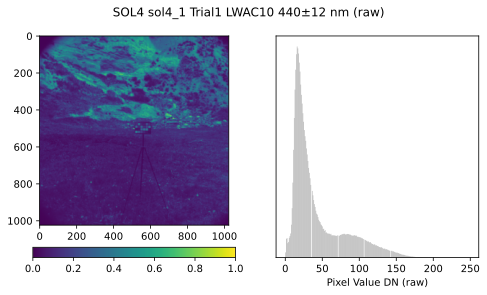

In [15]:
test_img.show_image('raw')

'bps' stretches the image such that the brightest pixel is the maximum allowed value for the display:

Stretching image using brightest pixel stretch


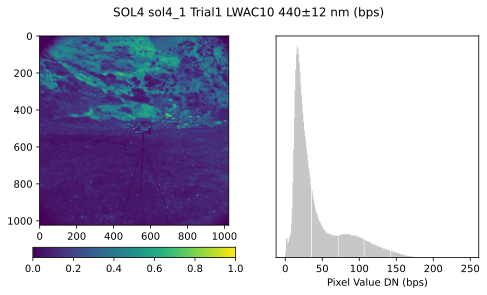

In [16]:
test_img.show_image('bps')

'99p' streches the image such that the 99th percentile pixel maps to the maximum allowed value for the display (all pixels brighter than this are clipped):

Stretching image using 99th percentile stretch


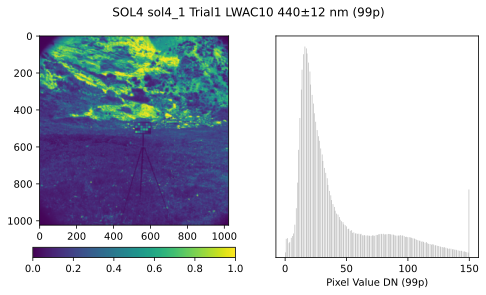

In [17]:
test_img.show_image('99p')

'wps' maps the white patch of the colour checker target to the maximum allowed value for the display (all pixels brighter than this are clipped). Note that this method requires user interaction to select the patch ROI:

If a mistake is made whilst setting the white patch roi, you can reset the values and start again, with:

test_img.reset_stretch_coefficient('wps')

We can exposure correct the image, and display (e.g. using bps)

In [18]:
test_img.exposure_correction()

Stretching image using brightest pixel stretch


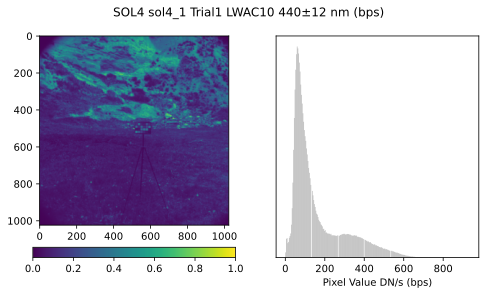

In [19]:
test_img.show_image('bps')

Saving the image:

In [20]:
test_img.export_image('raw')

PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_MS/single_frame/SOL4_sol4_1_Trial1_LWAC10_440_25_nm_raw.png')

In [21]:
test_img.export_image('bps')

Exporting image using brightest pixel stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_MS/single_frame/SOL4_sol4_1_Trial1_LWAC10_440_25_nm_bps.png')

In [22]:
test_img.export_image('99p')

Exporting image using 99th percentile stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_MS/single_frame/SOL4_sol4_1_Trial1_LWAC10_440_25_nm_99p.png')

That completes development for single frame processing.

## Loading a WAC RGB Image

Now we process WAC RGB images, using the aupy.RGB class.

Let's use the LWAC RGB set:

In [23]:
scene_info.lwac_rgb_files

[PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC2_T4.0_P-40.0_47.png'),
 PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC3_T4.0_P-40.0_48.png'),
 PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC4_T4.0_P-40.0_49.png')]

In [24]:
lwac_rgb_dict = scene_info.wac_rgb_file_dict(scene_info.lwac_rgb_files)

In [25]:
lwac_rgb_dict

[{'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC2_T4.0_P-40.0_47.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'WAC_RGB',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB')},
 {'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC3_T4.0_P-40.0_48.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'WAC_RGB',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB')},
 {'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_LWAC4_T4.0_P-40.0_49.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'WAC_RGB',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB')}]

In [26]:
lwac_rgb = aupy.RGB(lwac_rgb_dict, aupe_info)

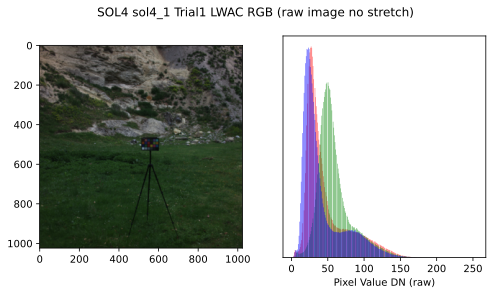

In [27]:
lwac_rgb.show_image()

Stretching image using brightest pixel stretch


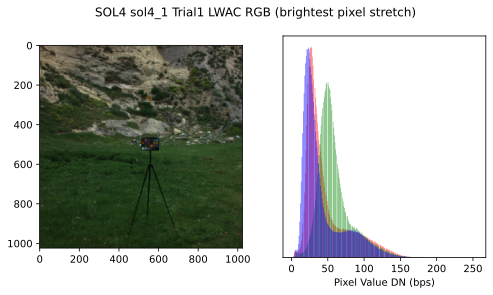

In [28]:
lwac_rgb.show_image('bps')

Stretching image using 99th percentile stretch


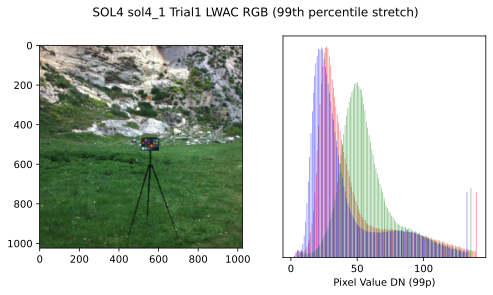

In [29]:
lwac_rgb.show_image('99p')

In [31]:
lwac_rgb.reset_balance_vector('wps')

Stretching image using white patch stretch
First draw an ROI around the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


2025-05-12 21:35:40.804 python[32039:1745459] +[IMKClient subclass]: chose IMKClient_Modern
2025-05-12 21:35:40.804 python[32039:1745459] +[IMKInputSession subclass]: chose IMKInputSession_Modern


Now draw an ROI around the white patch on the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


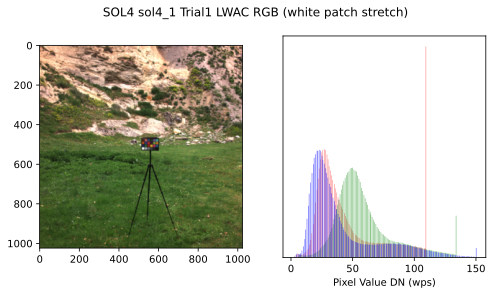

In [32]:
lwac_rgb.show_image('wps')

We can export these RGB images, again specifying which stretch to use during export.

In [33]:
lwac_rgb.export_image('bps')

Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_LWAC_RGB_bps.png')

In [34]:
lwac_rgb.export_image('99p')

Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_LWAC_RGB_99p.png')

In [35]:
lwac_rgb.export_image('wps')

Exporting image using white patch stretch
Stretching image using white patch stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_LWAC_RGB_wps.png')

Now let's look at the Right WAC:

In [36]:
rwac_rgb_dict = scene_info.wac_rgb_file_dict(scene_info.rwac_rgb_files)

In [37]:
rwac_rgb = aupy.RGB(rwac_rgb_dict, aupe_info)

Stretching image using brightest pixel stretch


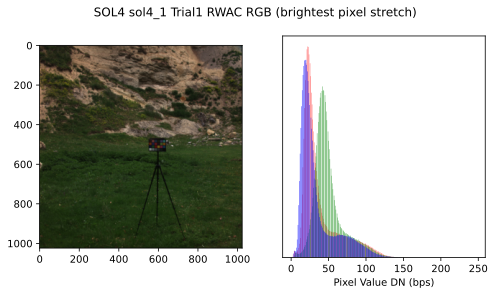

In [38]:
rwac_rgb.show_image('bps')

Stretching image using 99th percentile stretch


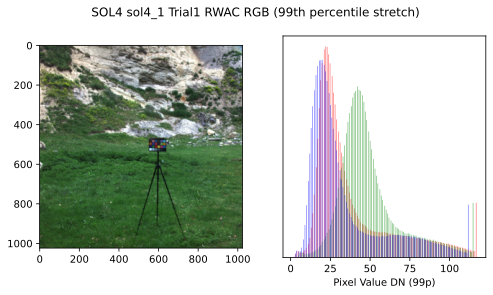

In [39]:
rwac_rgb.show_image('99p')

In [40]:
rwac_rgb.reset_balance_vector('wps')

Stretching image using white patch stretch
First draw an ROI around the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!
Now draw an ROI around the white patch on the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


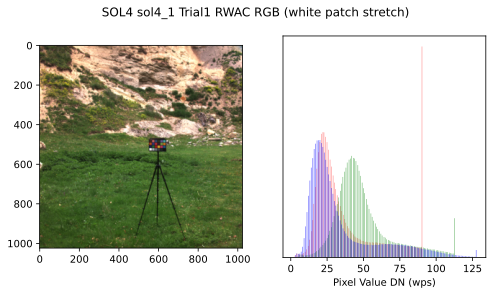

In [41]:
rwac_rgb.show_image('wps')

In [42]:
rwac_rgb.export_image('bps')
rwac_rgb.export_image('99p')
rwac_rgb.export_image('wps')

Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch
Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch
Exporting image using white patch stretch
Stretching image using white patch stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_RWAC_RGB_wps.png')

That covers the first pass of colour processing. Now we need to apply this to HRC, including debayering. Then, we can go back to more processing including the correction by colour checker sRGB value.

# HRC Image Debayering and Display

In [43]:
scene_info.hrc_files

[PosixPath('../../data/SOL4/sol4_1/sol4_1_0_HRC00_T4.0_P-40.0_46.png')]

In [44]:
hrc_file_dict = scene_info.hrc_file_dict(scene_info.hrc_files[0])

In [45]:
hrc_file_dict

[{'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_HRC00_T4.0_P-40.0_46.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'HRC',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/HRC')},
 {'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_HRC00_T4.0_P-40.0_46.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'HRC',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/HRC')},
 {'filepath': PosixPath('../../data/SOL4/sol4_1/sol4_1_0_HRC00_T4.0_P-40.0_46.png'),
  'trial': 'Trial1',
  'scene': 'sol4_1',
  'sol': 'SOL4',
  'img_type': 'HRC',
  'out_dir': PosixPath('../../processed/SOL4/sol4_1/Trial1/HRC')}]

In [46]:
hrc_rgb = aupy.HRC(hrc_file_dict, aupe_info)

We can look at the un-debayered image:

Stretching image using brightest pixel stretch


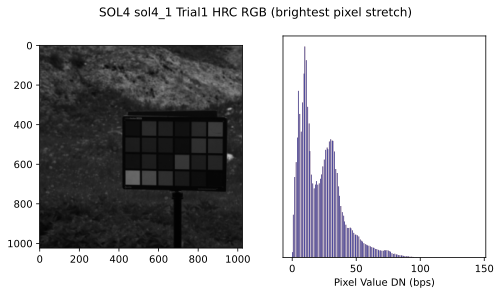

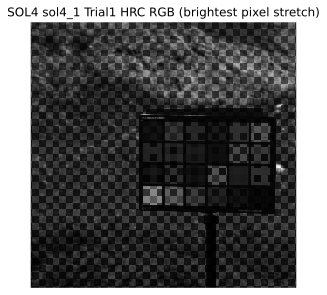

In [47]:
hrc_rgb.show_image('bps')

And now we apply debayering:

In [48]:
hrc_rgb.debayer()

Showign with brightest pixel stretch, we see the green is dominant:

Stretching image using brightest pixel stretch


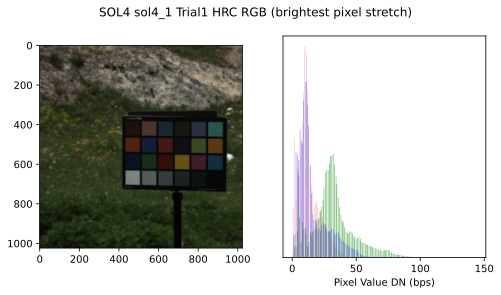

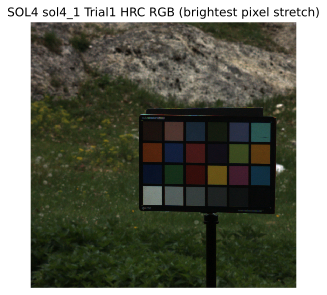

In [49]:
hrc_rgb.show_image('bps')

Stretching image using 99th percentile stretch


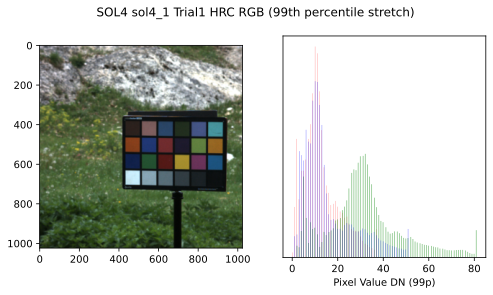

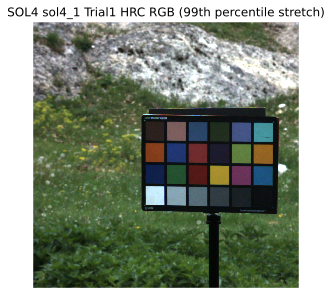

In [50]:
hrc_rgb.show_image('99p')

Stretching image using white patch stretch
First draw an ROI around the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!
Now draw an ROI around the white patch on the calibration target
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


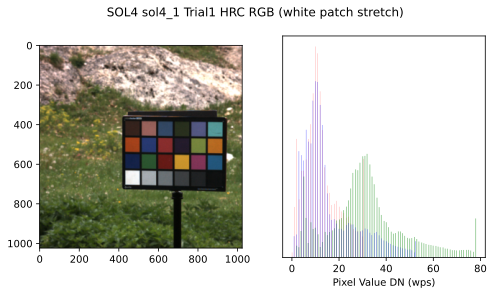

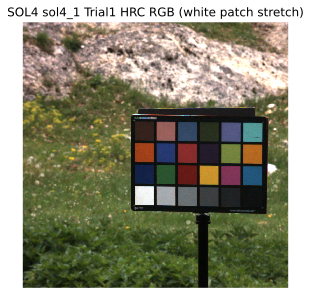

In [51]:
hrc_rgb.show_image('wps')

Here's what the target should look like...

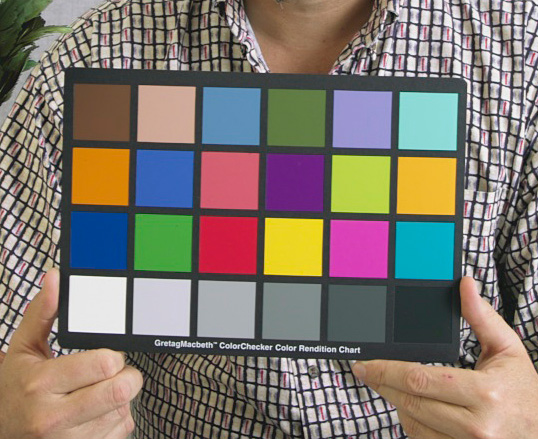

In [52]:
from IPython.display import Image, display

# Display the Gretag-MacBeth ColorChecker image
image_path = "Gretag-MacBeth_ColorChecker.jpg"  # Update the path if necessary
display(Image(filename=image_path))

In [53]:
hrc_rgb.export_image('bps')
hrc_rgb.export_image('99p')
hrc_rgb.export_image('wps')

Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch
Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch
Exporting image using white patch stretch
Stretching image using white patch stretch


PosixPath('../../processed/SOL4/sol4_1/Trial1/HRC/SOL4_sol4_1_Trial1_HRC_RGB_wps.png')

We're now in a position to batch process all images using the 99th percentile stretch, or by using the cal targ white patch. Let's do some select scenes... e.g. including the Stromatolites.

# Developing Proper Colour Correction

We're now in a position where we can in principal draw each patch on the calibration target, and then it follows that we can load in the calibration target patch reference data, and find the colour correction matrix that best colour balances the scene.

Steps:
1. Open the colour target image
2. Load up the calibration target into a new calibration target object
3. draw the calibration target patches
4. get the value for each scene target patch
5. formulate the colour correction matrix problem
6. solve the colour correction matrix
7. apply the colour correction matrix

In [54]:
cal_targ = aupy.CalibrationTarget()

# Multispectral Processing

Can we quickly get the Multispectral Scenes working also?

In [55]:
class aupe_img:
    def __init__(self, filepath):
        # check if the file exists
        filepath = Path(filepath)
        if not filepath.is_file():
            raise FileNotFoundError(f"File {filepath} does not exist.")
        self.filepath = filepath
        self.sol = filepath.parent.parent.stem
        self.scene = filepath.parent.stem
        self.channel = filepath.name.split('_')[3]
        # attributes
        self.camname = None # str // get from filename
        self.timestamp = None # str TODO make time object of some kind
        self.camnum = None # int
        self.exposure = None # float
        # metadata
        self.width = None # int
        self.height = None # int
        self.filternum = None # str
        self.cwl = None # float
        self.fwhm = None # float
        self.dtype = None # str
        self.units = None # str
        # data
        self.img_raw = None # np.ndarry        
        self.img_bps = None # np.ndarray
        self.img_wps = None
        self.img_ctcc = None
        self.img_ctrc = None

    def load_img(self):
        """Load the image and metadata from the image file exif data
        """
        # read the metadata from the image file using the PIL exif reader
        img = PIL.Image.open(self.filepath)
        metadata = img.info
        # set the attributes
        self.timestamp = metadata['AU_timestampUTC']
        self.camnum = int(metadata['AU_camNum'])
        self.exposure = float(metadata['AU_exposureTime'])
        self.pan = float(metadata['AU_pan'])
        self.tilt = float(metadata['AU_tilt'])
        self.filternum = int(metadata['AU_filterNum'])
        print(self.filepath)
        print(self.filternum)
        self.camname = CAM_DICT[self.camnum]
        # self.cwl = ...
        # self.fwhm = ...
        # read the image data
        self.img = np.array(img)
        # derive metadata from the image data
        self.width = self.img.shape[1]
        self.height = self.img.shape[0]
        self.dtype = self.img.dtype
        self.units = 'DN'
        self.level = 'raw'

    def show_img(self):
        """Display the image using matplotlib,
        and optionally show the histogram of the image data.
        """  

        title = f"{self.sol} {self.scene} {self.channel}"

        fig, ax = plt.subplots(1,2, figsize=(8, 4))
        disp = ax[0].imshow(self.img, cmap='viridis')
        # add colorbar
        plt.colorbar(disp,fraction=0.046, pad=0.10, orientation='horizontal')
        
        ax[1].hist(self.img.ravel(), bins=256, color='gray', alpha=0.5)
        # if dtype is uint8, set the xlim to 0-255
        if self.dtype == np.uint8:
            ax[1].set_xlim(0, 255)
        ax[1].set_xlabel("Pixel Value")                
        ax[1].tick_params(labelleft=False, left=False)
        # add title and labels
        fig.suptitle(f"{self.sol} {self.scene} {self.channel}")
        plt.show()  

        # show the image at full resolution
        plt.imshow(self.img, interpolation='none')
        plt.axis('off')
        # set the title
        plt.title(f"{self.sol} {self.scene} {self.units}")
        
    def exposure_correct(self):
        """Apply exposure correction and convert to float
        """     
        # convert to float
        img_flt = self.img.astype(np.float64)
        # apply exposure correction
        self.img = self.img / self.exposure
        # set the units to DN/s
        self.units = 'DN/s'
        # set the dtype to float32
        self.dtype = np.float32   

    def __getitem__(self, item):
        return self.img[item]

    def __setitem__(self, key, value):
        self.img[key] = value

    def __len__(self):
        return len(self.img)

In [56]:
# set aupe_wac_rgb class that inherits from aupe_img
class aupe_wac_rgb():
    def __init__(self, filepaths):
        self.img_stack = []
        for filepath in filepaths:
            img = aupe_img(filepath)
            img.load_img()
            img.exposure_correct()
            self.img_stack.append(img) 
        self.sol = self.img_stack[0].sol
        self.scene = self.img_stack[0].scene     
        self.dtype = self.img_stack[0].dtype 
        self.units = self.img_stack[0].units  
        self.camname = self.img_stack[0].camname           
        self.drgb_img = None
        scene_dir = Path("..", "data", self.sol, self.scene)
        out_dir = Path(scene_dir, 'processed', 'WAC_RGB')
        out_dir.mkdir(parents=True, exist_ok=True)
        self.out_dir = out_dir

    def drgb_stack(self):
        """Stack the RGB channels into a single image
        """
        # stack the channels
        r = self.img_stack[0].img
        g = self.img_stack[1].img
        b = self.img_stack[2].img
        self.drgb_img = np.dstack((r, g, b))

    def show_drgb_img(self):
        """Display the debayered image using matplotlib,
        and optionally show the histogram of the image data.
        """
        fig, ax = plt.subplots(1,2, figsize=(8, 5))  
        norm_img = self.drgb_img / np.max(self.drgb_img)      
        disp = ax[0].imshow(norm_img)
        
        # title
        title = f"{self.sol} {self.scene} {self.camname} {self.units}"
        filename = f"{self.sol}_{self.scene}_{self.camname}_RGB.png"

        # for each channel, show a histogram
        ax[1].hist(self.drgb_img[:,:,0].ravel(), bins=256, color='red', alpha=0.5)
        ax[1].hist(self.drgb_img[:,:,1].ravel(), bins=256, color='green', alpha=0.5)
        ax[1].hist(self.drgb_img[:,:,2].ravel(), bins=256, color='blue', alpha=0.5)
        ax[1].tick_params(labelleft=False, left=False)
        if self.dtype == np.uint8:
            ax[1].set_xlim(0, 255)
        # label x axis with units
        ax[1].set_xlabel(f"Pixel Value ({self.units})")
        # add title and labels
        fig.suptitle(title)
        plt.show()

        # show the image at full resolution
        plt.imshow(norm_img, interpolation='none')
        plt.axis('off')
        # set the title
        plt.title(title)

        # use opencv to write the image to file
        out_file = self.out_dir / filename
        # convert to uint8
        norm_img = (norm_img * 255).astype(np.uint8)
        cv2.imwrite(out_file, norm_img)
        
    # balance the colours
    def colour_balance(self):
        """Balance the colours of the image using the brightest pixel
        """
        # get max value in each channel
        max_r = np.percentile(self.drgb_img[:,:,0], 99.5)
        max_g = np.percentile(self.drgb_img[:,:,1], 99.5)
        max_b = np.percentile(self.drgb_img[:,:,2], 99.5)
        # get the max value
        max_val = np.max([max_r, max_g, max_b])
        # get the ratio of each channel to the max value
        r_ratio = max_val / max_r
        g_ratio = max_val / max_g
        b_ratio = max_val / max_b
        # apply the ratio to each channel
        img = self.drgb_img.copy()
        img[:,:,0] = img[:,:,0] * r_ratio
        img[:,:,1] = img[:,:,1] * g_ratio
        img[:,:,2] = img[:,:,2] * b_ratio
        # set the new image
        self.drgb_img = img
        # set the units to [] 99.5 percentile stretch
        self.units = f'{self.units} 99.5 pct stretch'


In [57]:
# set aupe_hrc class that inherits from aupe_img
class aupe_hrc(aupe_img):
    def __init__(self, filepath):
        super().__init__(filepath)
        self.load_img()
        self.drgb_img = None # the device-RGB space image
        # self.srgb_img = None # the sRGB space image
        scene_dir = Path("..", "data", self.sol, self.scene)
        out_dir = Path(scene_dir, 'processed', 'HRC')
        out_dir.mkdir(parents=True, exist_ok=True)
        self.out_dir = out_dir
    
    def debayer(self):
        """Debayer the image using the cv2 function
        """
        # debayer the image
        col_img = cv2.cvtColor(self.img, cv2.COLOR_BAYER_BG2BGR)
        self.drgb_img = col_img        
    
    def show_drgb_img(self):
        """Display the debayered image using matplotlib,
        and optionally show the histogram of the image data.
        """
        fig, ax = plt.subplots(1,2, figsize=(8, 4))
        disp = ax[0].imshow(self.drgb_img)

        # title
        title = f"{self.sol} {self.scene} {self.camname} {self.units}"
        filename = f"{self.sol}_{self.scene}_{self.camname}_RGB.png"
        
        # for each channel, show a histogram
        ax[1].hist(self.drgb_img[:,:,0].ravel(), bins=256, color='red', alpha=0.5)
        ax[1].hist(self.drgb_img[:,:,1].ravel(), bins=256, color='green', alpha=0.5)
        ax[1].hist(self.drgb_img[:,:,2].ravel(), bins=256, color='blue', alpha=0.5)
        ax[1].tick_params(labelleft=False, left=False)
        # if dtype is uint8, set the xlim to 0-255
        if self.dtype == np.uint8:
            ax[1].set_xlim(0, 255)
        # label x axis with units
        ax[1].set_xlabel(f"Pixel Value ({self.units})")
        # add title and labels
        fig.suptitle(title)
        plt.show()

        # show the image at full resolution
        plt.imshow(self.drgb_img, interpolation='none')
        plt.axis('off')
        
        # use opencv to write the image to file
        out_file = self.out_dir / filename
        cv2.imwrite(out_file, self.drgb_img)

    # balance the colours
    def colour_balance(self):
        """Balance the colours of the image using the brightest pixel
        """
        # get max value in each channel
        max_r = np.percentile(self.drgb_img[:,:,0], 99.5)
        max_g = np.percentile(self.drgb_img[:,:,1], 99.5)
        max_b = np.percentile(self.drgb_img[:,:,2], 99.5)
        # get the max value
        max_val = np.max([max_r, max_g, max_b])
        # get the ratio of each channel to the max value
        r_ratio = max_val / max_r
        g_ratio = max_val / max_g
        b_ratio = max_val / max_b
        # apply the ratio to each channel
        img = self.drgb_img.copy()
        img[:,:,0] = img[:,:,0] * r_ratio
        img[:,:,1] = img[:,:,1] * g_ratio
        img[:,:,2] = img[:,:,2] * b_ratio
        # set the new image
        self.drgb_img = img
        # set the units to [] 99.5 percentile stretch
        self.units = f'{self.units} 99.5 pct stretch'
    

# Set data input and output directories.

Set the sol and scene strings: edit as needed

In [58]:
sol = 'SOL4' # set this manually
scene = 'sol4_1' # set this manually

In [59]:
scene_dir = Path("..", "data", sol, scene)
# check that the directory exists
if not scene_dir.exists():
    raise FileNotFoundError(f"Directory {scene_dir} does not exist")

FileNotFoundError: Directory ../data/SOL4/sol4_1 does not exist

Builds the processed data directory tree.

TODO move this into the classes

In [ ]:
out_dir = Path(scene_dir, 'processed')
out_dir.mkdir(parents=True, exist_ok=True)
hrc_dir = Path(out_dir, 'HRC')
hrc_dir.mkdir(parents=True, exist_ok=True)
wac_rgb_dir = Path(out_dir, 'WAC_RGB')
wac_rgb_dir.mkdir(parents=True, exist_ok=True)
wac_ms_dir = Path(out_dir, 'WAC_MS')
wac_ms_dir.mkdir(parents=True, exist_ok=True)
# TODO: rectified images


# Access raw input images


Search the scene_dir and list all of the png files.

In [ ]:
png_files = list(scene_dir.glob("*.png"))
# sort by name
png_files.sort()

Organise the files into HRC, WAC_RGB, WAC_MS.

TODO move this into the class handler

In [ ]:
# if the filename inlcudes the string 'HRC' put in list hrc_imgs
hrc_files = []
# if the filename includes any of 'WAC_1', 'WAC_2', 'WAC_3' put in list wac_rgb_imgs
lwac_rgb_files = []
rwac_rgb_files = []
# else, put the filename in list wac_ms_imgs
wac_ms_files = []
for png_file in png_files:
    if 'HRC' in png_file.name:
        hrc_files.append(png_file)
    elif 'LWAC2_' in png_file.name or 'LWAC3_' in png_file.name or 'LWAC4_' in png_file.name:
        lwac_rgb_files.append(png_file)
    # elif 'RWAC1_' in png_file.name or 'RWAC3_' in png_file.name or 'RWAC4_' in png_file.name:
    elif 'RWAC2_' in png_file.name or 'RWAC3_' in png_file.name or 'RWAC4_' in png_file.name:
        rwac_rgb_files.append(png_file)
    else:
        wac_ms_files.append(png_file)

Check the list of files found.

In [ ]:
print(f"Found {len(hrc_files)} HRC images:")
for file in hrc_files:
    print(f"  {file.name}")
print(f"Found {len(lwac_rgb_files)} LWAC RGB images:")
for file in lwac_rgb_files:
    print(f"  {file.name}")
print(f"Found {len(rwac_rgb_files)} RWAC RGB images:")
for file in rwac_rgb_files:
    print(f"  {file.name}")
print(f"Found {len(wac_ms_files)} WAC MS images:")
for file in wac_ms_files:
    print(f"  {file.name}")

In [ ]:
# print exposure times for each image to get which are likely to be the RGB channels.
for png_file in png_files:
    img = PIL.Image.open(png_file)
    metadata = img.info
    print(f"{png_file.name}: {metadata['AU_exposureTime']}, {metadata['AU_filterNum']}, {metadata['AU_camNum']}")

# Set/Read AUPE metadata
   1. Map channel names to cwl, fwhm
   2. Read calibration target reflectance data
   3. sample calibration target reflectance to channel cwls & fwhms


# Process HRC Colour Images

In [ ]:
for hrc_file in hrc_files:
    # create the aupe_hrc object
    hrc_img = aupe_hrc(hrc_file)
    # show the image
    hrc_img.show_img()
    # # debayer the image
    hrc_img.debayer()
    hrc_img.colour_balance()
    # show the debayered image
    hrc_img.show_drgb_img()

Need a scene for HRC that includes the Macbeth ColorChecker, so that we can do white balancing.

# Process RGB frames:
   1. Load RGB channels: images + metadata
   2. Apply flat fields (?)
   3. Exposure correct
   4. Convert to 8-bit, stack to RGB
   5. ROI select Colorchecker patches
   6. Get dRGB patch values (from ROI)
   7. Solve for colour correction matrix to sRGB D65 reference values
   8. Apply color correction matrix to dRGB image

In [ ]:
lwac_rgb_files[0:3]

In [ ]:
lwac_rgb_img = aupe_wac_rgb(lwac_rgb_files[0:3])

In [ ]:
lwac_rgb_img.drgb_stack()

In [ ]:
lwac_rgb_img.show_drgb_img()

In [ ]:
lwac_rgb_img.colour_balance()
lwac_rgb_img.show_drgb_img()

In [ ]:
rwac_rgb_files[0:3]

In [ ]:
rwac_rgb_img = aupe_wac_rgb(rwac_rgb_files[0:3])

In [ ]:
rwac_rgb_img.drgb_stack()

In [ ]:
rwac_rgb_img.show_drgb_img()

In [ ]:
lwac_rgb_img.colour_balance()
lwac_rgb_img.show_drgb_img()

## Select the ROIs of the Calibration Target

In [ ]:
# caltarg_roi = cv2.selectROI(lwac_rgb_img.drgb_img)


# Process multispectral frames
   1. Load multispectral channels: images + metadata
   2. Apply flat fields (?)
   3. Exposure correct
   4. ROI select Colorchecker patches (or import from RGB?)
   5. Get float DN/s patch values 
   6. Fit patch values to reference reflectance, for each channel
   7. Apply reflectance calibration coefficients to each image


# Warp LWAC to RWAC
   1. Find tie points from LWAC RGB -> RWAC RGB
   2. Get homography matrix
   3. Apply rectification to LWAC RGB
   4. Apply rectification to LWAC multispec